In [87]:
import sys
import os
from Args import get_notebook_args, Args
sys.path.insert(0, os.path.abspath('../..'))
from src.DataLoad import load_source_data
import torch
import torch.optim as optim
from torch.utils.tensorboard import SummaryWriter
from src.Epoch import train_epoch
from src.utility import precompute_gaussian_params
from src.Neural import CNF, RunningAverageMeter
from src.plot import *
from src.PreProcess import *
from src.DataLoad import *

Default data path: ./clouds_2d.npz
Default time labels: ['initial', 'terminal', 'bump']
Default ot dimension: 2
Default time points: [0, 1]
Data type: <class 'numpy.lib.npyio.NpzFile'>
Available keys in npz file: ['initial', 'terminal', 'bump']
time point initial data shape: torch.Size([3000, 2])
time point terminal data shape: torch.Size([3000, 2])
support points data shape: torch.Size([5000, 2])


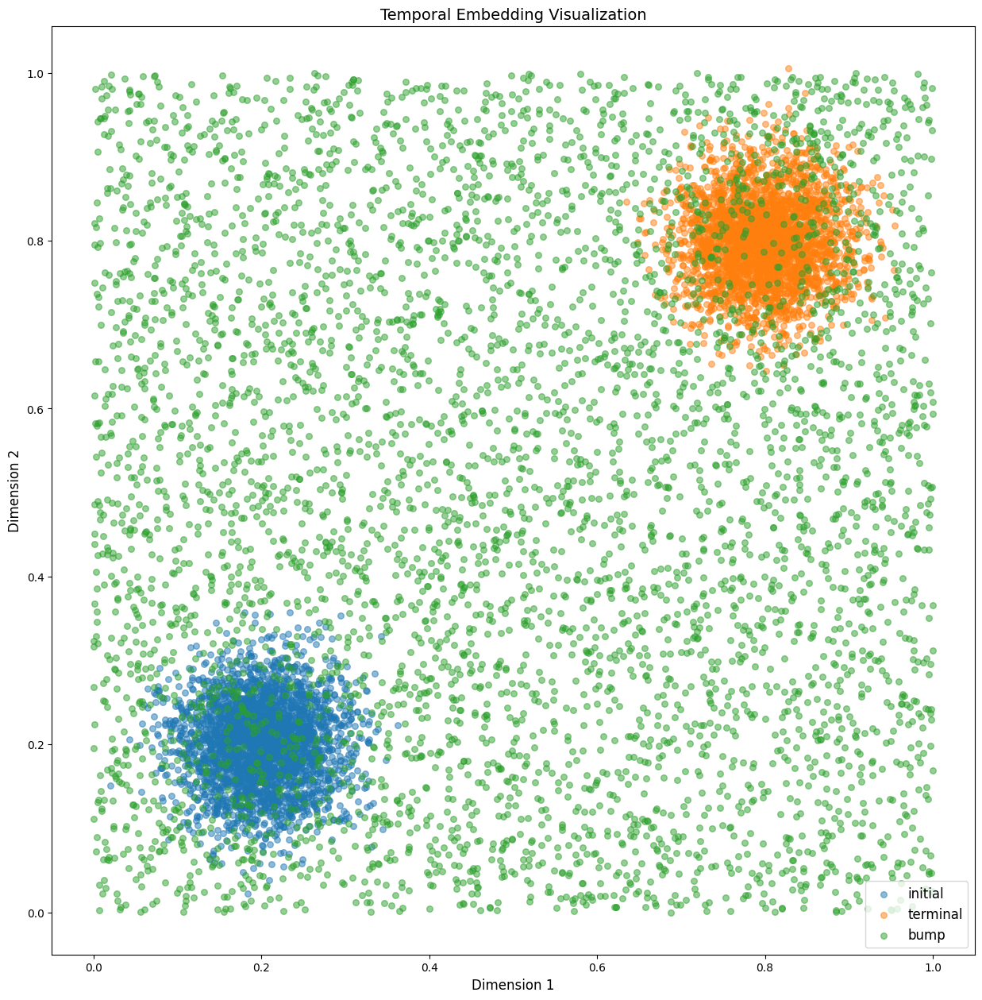

In [88]:
args = get_notebook_args()
print(f"Default data path: {args.data_path}")
print(f"Default time labels: {args.time_labels}")
print(f"Default ot dimension: {args.otdim}")
print(f"Default time points: {args.time_points}")
data_train, data_support= load_source_data(args.data_path, args.time_labels, args.support_points)


device = torch.device(f'cuda:{args.gpu}' if torch.cuda.is_available() and args.gpu >= 0 else 'cpu')
primary_data = [data for data in data_train] + [data for data in data_support]

# record the number of samples in each group
lengths = [data.shape[0] for data in primary_data] 

# concatenate and normaliz


total_primal = torch.cat(primary_data, dim=0)
#total_primal, norm_params = normalize_to_unit_cube(total_primal)

'''
# split back according to the recorded lengths
split_points = torch.cumsum(torch.tensor(lengths), dim=0).tolist()
start = 0
normalized_data = []

for end in split_points:
    normalized_data.append(total_primal[start:end])
    start = end

# update primary_data to the normalized data
primary_data = normalized_data
''' 
time_labels = args.time_labels

import matplotlib.pyplot as plt
%matplotlib inline

device = torch.device(f'cuda:{args.gpu}' if torch.cuda.is_available() and args.gpu >= 0 else 'cpu')

fig, ax = plot_temporal_embeddings(primary_data, args.time_labels)
plt.show()

In [89]:



density_precompute_list = []
for i in range(len(args.time_points)):
    z_curr_primal = primary_data[i]
    sigma = args.sigma
    weights, means, precisions = precompute_gaussian_params(z_curr_primal, sigma, device)
    density_precompute_list.append((weights, means, precisions))
    
time_steps_list = []
for t_idx in range(len(args.time_points) - 1):
    dt = args.dt
    t0, t1 = args.time_points[t_idx], args.time_points[t_idx + 1]
    
    time_steps_short_backward = torch.linspace(t1, t0, int((t1-t0)/dt)+1).to(device)
    time_steps_short_forward = torch.linspace(t0, t1, int((t1-t0)/dt)+1).to(device)
    
    t_init = args.time_points[0]
    time_steps_long_backward = torch.linspace(t1, t_init, int((t1-t_init)/dt)+1).to(device)
    time_steps_long_forward = torch.linspace(t_init, t1, int((t1-t_init)/dt)+1).to(device)
    
    time_steps_list.append((time_steps_short_backward, time_steps_short_forward, 
                            time_steps_long_backward, time_steps_long_forward))
print(time_steps_list)

func = CNF(in_out_dim=args.otdim, hidden_dim=args.hidden_dim, n_hiddens=args.n_hiddens,activation=args.activation,UnbalancedOT=args.UnbalancedOT).to(device)
#optimizer = optim.Adam(func.parameters(), lr=args.lr)
optimizer = optim.AdamW(
func.parameters(),
lr=args.lr,
weight_decay=0.001
)

total_steps = args.niters
gamma = (5e-6 / args.lr) ** (2.0 / total_steps) 

loss_meter = RunningAverageMeter()

scheduler = torch.optim.lr_scheduler.ExponentialLR(
    optimizer,
    gamma=gamma,
    verbose=True
)


from src.utility import load_checkpoint
from sklearn.mixture import GaussianMixture
from sklearn.neighbors import KernelDensity
from collections import deque
from functools import partial
from torchdiffeq import odeint
from src.DataLoad import get_exact_batch
from src.MapSpace import map_to_nearest_manifold
from PIL import Image
import glob
from collections import deque
from src.Loss import Manifold_reconstruction_loss
    
load_checkpoint(func, optimizer, scheduler, args, ckpt_path='ckpt_iter_800.pth')

[(tensor([1.0000, 0.8000, 0.6000, 0.4000, 0.2000, 0.0000], device='cuda:0'), tensor([0.0000, 0.2000, 0.4000, 0.6000, 0.8000, 1.0000], device='cuda:0'), tensor([1.0000, 0.8000, 0.6000, 0.4000, 0.2000, 0.0000], device='cuda:0'), tensor([0.0000, 0.2000, 0.4000, 0.6000, 0.8000, 1.0000], device='cuda:0'))]
Loaded checkpoint from ./checkpoint/ckpt_iter_800.pth
Resuming from iteration 800 with loss 0.0000


/home/jfwang/miniconda3/envs/SynOT/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/media/hdd/jfwang/sOT/TraInf4git/src/utility.py:59: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use cas

800

In [90]:
viz_samples = 5000
viz_timesteps = 41
time_points = [1, 0]


with torch.no_grad():
    torch.manual_seed(42)
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(42)

    # Start from t0
    z0_viz = get_exact_batch(viz_samples, device, primary_data[1])[0]
    z1_viz = get_exact_batch(viz_samples, device, primary_data[0])[0]
    logp_diff_t0 = torch.zeros(viz_samples, 1).type(torch.float32).to(device)
    
    # Generate acomplete evolution trajectory
    all_samples = []
    all_times = []
    
    # Generate evolution for each adjacent time point pair
    for t_idx in range(len(time_points)-1):
        current_times = np.linspace(time_points[t_idx], time_points[t_idx+1], viz_timesteps)
        all_times.extend(current_times)
        
        if t_idx == 0:
            initial_point = (z0_viz, logp_diff_t0)
        else:
            initial_point = (z_t_samples_primal[-1], log_zt_sample[-1])
        
        z_t_samples_primal, log_zt_sample = odeint(
            func,
            initial_point,
            torch.tensor(current_times).to(device),
            atol=1e-5,
            rtol=1e-5,
            method='rk4',
        )
        
        all_samples.append(z_t_samples_primal)

    # Concatenate all samples
    all_samples_backward = torch.cat(all_samples, dim=0)
    
    print(all_samples_backward.shape)

torch.Size([41, 5000, 2])


In [91]:
time_points = [0, 1]


with torch.no_grad():
    torch.manual_seed(42)
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(42)

    # Start from t0
    z0_viz = get_exact_batch(viz_samples, device, primary_data[0])[0]
    z1_viz = get_exact_batch(viz_samples, device, primary_data[1])[0]
    logp_diff_t0 = torch.zeros(viz_samples, 1).type(torch.float32).to(device)
    
    # Generate acomplete evolution trajectory
    all_samples = []
    all_times = []
    
    # Generate evolution for each adjacent time point pair
    for t_idx in range(len(time_points)-1):
        current_times = np.linspace(time_points[t_idx], time_points[t_idx+1], viz_timesteps)
        all_times.extend(current_times)
        
        if t_idx == 0:
            initial_point = (z0_viz, logp_diff_t0)
        else:
            initial_point = (z_t_samples_primal[-1], log_zt_sample[-1])
        
        z_t_samples_primal, log_zt_sample = odeint(
            func,
            initial_point,
            torch.tensor(current_times).to(device),
            atol=1e-5,
            rtol=1e-5,
            method='rk4',
        )
        
        all_samples.append(z_t_samples_primal)

    # Concatenate all samples
    all_samples_forward = torch.cat(all_samples, dim=0)

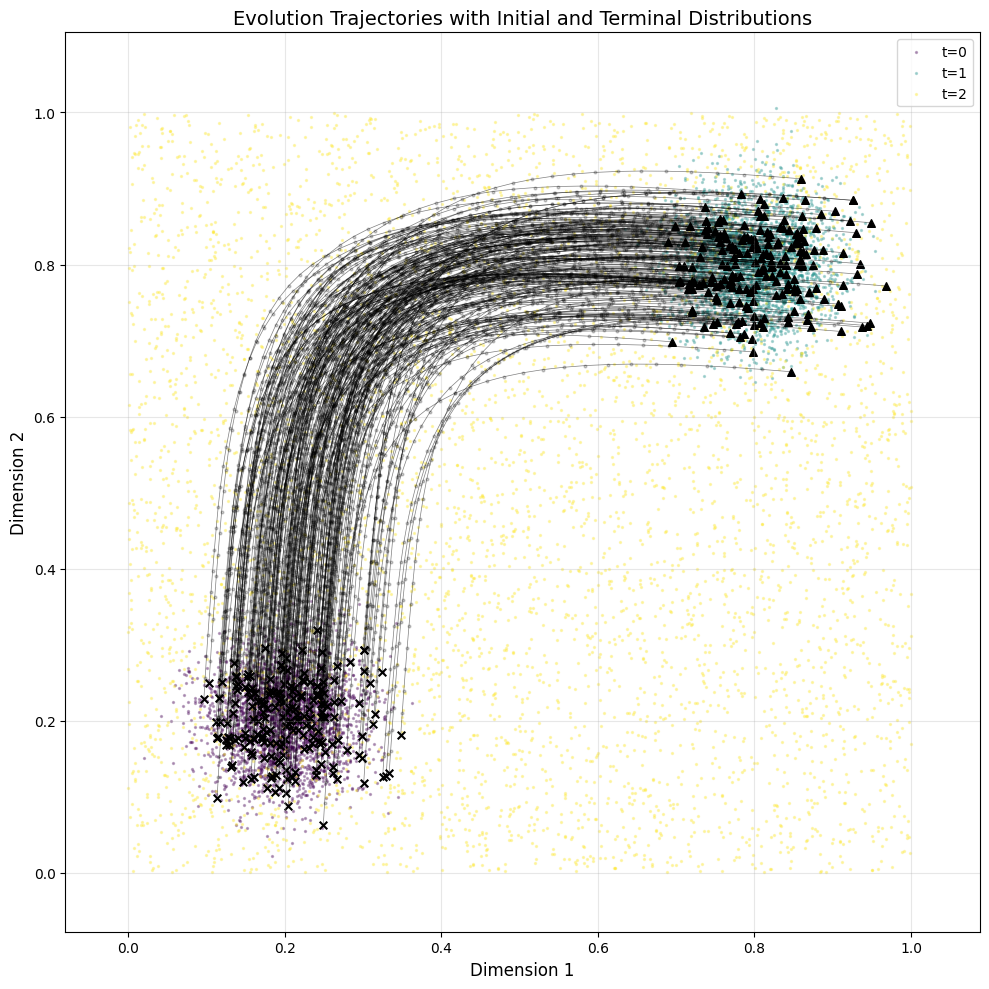

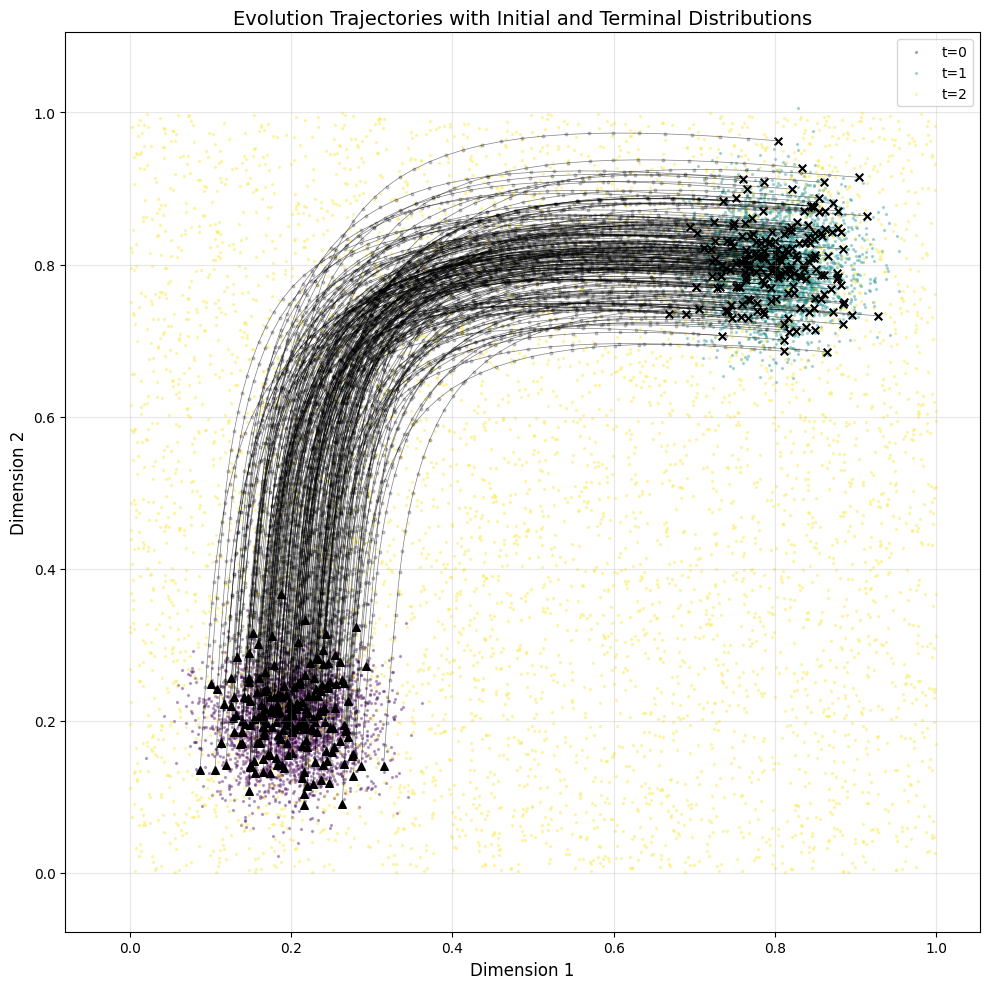

In [92]:
import matplotlib.pyplot as plt
import numpy as np
from src.plot import plot_trajectory_and_distribution
# Convert tensors to numpy if needed
data_train = [d.cpu().numpy() if torch.is_tensor(d) else d for d in primary_data]
all_samples = all_samples.cpu().numpy() if torch.is_tensor(all_samples) else all_samples

# Create visualization
plot_trajectory_and_distribution(data_train, all_samples_forward.cpu().numpy(), n_trajectories=200)
plot_trajectory_and_distribution(data_train, all_samples_backward.cpu().numpy(), n_trajectories=200)

In [93]:
from src.plot import visualize_evolution
reverse_trajectory = torch.flip(all_samples_backward, dims=[0]).cpu()
visualization = visualize_evolution(
    reverse_trajectory, 
    terminal_samples=primary_data[-2].cpu(),
    save_path='evolution_animation_reconstruction.gif', 
    fps=10, 
    dpi=100  
)
display(visualization)

In [94]:


secondary_space, secondary_support= load_source_data(args.sync_data_path, args.time_labels, args.support_points)
# record the number of samples in each group
secondary_data = secondary_space + secondary_support


lengths_secondary = [data.shape[0] for data in secondary_space] + [data.shape[0] for data in secondary_support]

# concatenate and normaliz


total_secondary = torch.cat(secondary_data, dim=0)
'''
total_secondary, norm_params = normalize_to_unit_cube(total_secondary)

# split back according to the recorded lengths
split_points = torch.cumsum(torch.tensor(lengths_secondary), dim=0).tolist()
start = 0
normalized_data = []

for end in split_points:
    normalized_data.append(total_secondary[start:end])
    start = end

# update primary_data to the normalized data
secondary_data = normalized_data 

'''

Data type: <class 'numpy.lib.npyio.NpzFile'>
Available keys in npz file: ['initial', 'terminal', 'bump']
time point initial data shape: torch.Size([3000, 3])
time point terminal data shape: torch.Size([3000, 3])
support points data shape: torch.Size([5000, 3])


'\ntotal_secondary, norm_params = normalize_to_unit_cube(total_secondary)\n\n# split back according to the recorded lengths\nsplit_points = torch.cumsum(torch.tensor(lengths_secondary), dim=0).tolist()\nstart = 0\nnormalized_data = []\n\nfor end in split_points:\n    normalized_data.append(total_secondary[start:end])\n    start = end\n\n# update primary_data to the normalized data\nsecondary_data = normalized_data \n\n'

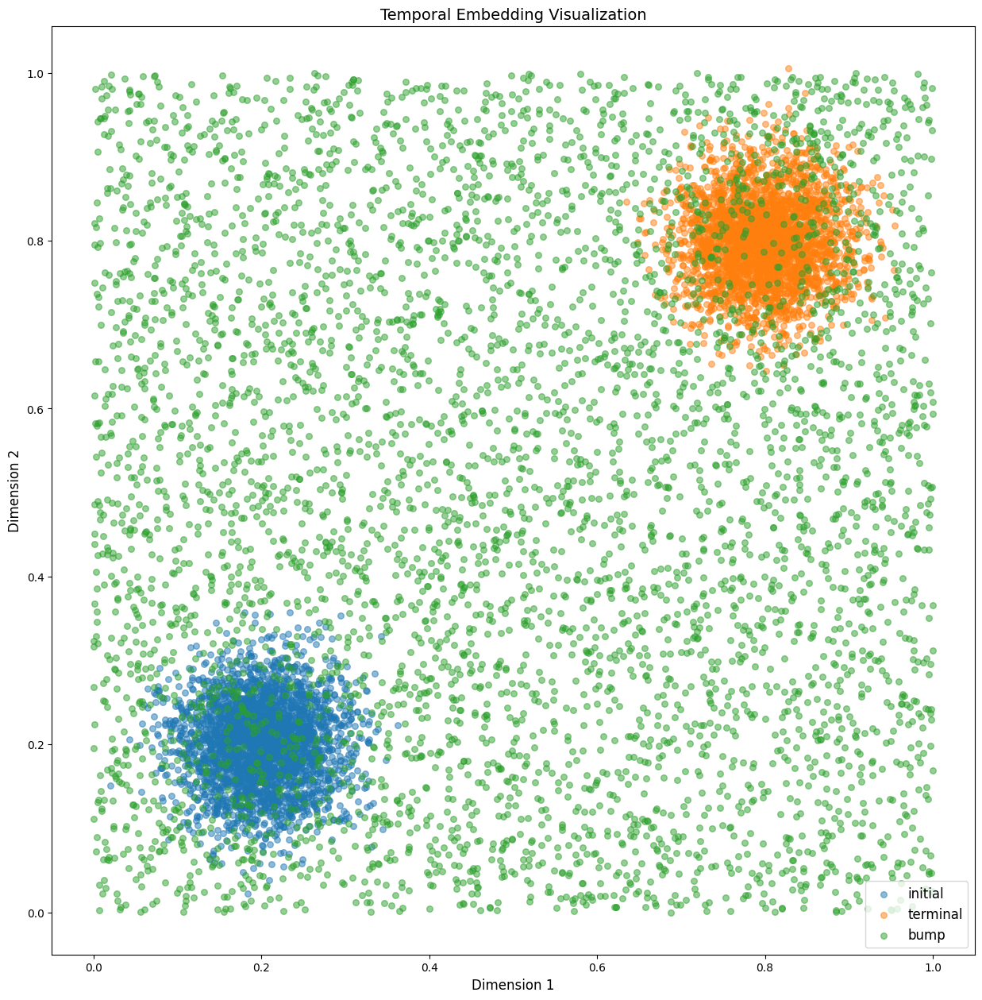

In [95]:
fig, ax = plot_temporal_embeddings(secondary_data, time_labels=args.time_labels, TwoDplot=True)
plt.show()

In [96]:
import torch
import torch.nn.functional as F

def map_backward_continuous(
    traj_points, support_points_main, support_points_aux, sigma=0.1, device=None, aux_weight=0.1, distance_threshold=0.05
):
    """
    Attention-based projection mapping.
    
    traj_points: (N, Sample, dim_1)
    support_points_main: (n_support, dim_1)
    support_points_aux: (n_support, dim_2)
    
    Returns:
        mapped_indices: (N, Sample, n_support)
        weights: (N, Sample, n_support)
    """
    N, Sample, dim_1 = traj_points.shape
    n_support = support_points_main.shape[0]

    mapped_indices = []
    weights = []

    # Optional normalization for stability
    support_points_main_norm = F.normalize(support_points_main, dim=1)
    support_points_aux_norm = F.normalize(support_points_aux, dim=1)

    for t in range(N):
        traj_points_t = F.normalize(traj_points[t], dim=1)

        # Attention scores: dot product similarity
        attention_scores_main = torch.matmul(traj_points_t, support_points_main_norm.T)  # (Sample, n_support)

        if t == 0:
            # Apply Gaussian mask to enforce locality
            dists_main = torch.cdist(traj_points[t], support_points_main)
            mask = dists_main > 0.002
            attention_scores_main = attention_scores_main.masked_fill(mask, -1e6)

            # Soft selection with attention
            soft_weights = torch.softmax(attention_scores_main, dim=1)

            combined_weights = soft_weights

            mean_main = (support_points_main * combined_weights.unsqueeze(-1)).sum(dim=1)
            mean_aux = (support_points_aux * combined_weights.unsqueeze(-1)).sum(dim=1)

        else:
            # Compute attention scores between last mapped mean and support points
            mean_main_norm = F.normalize(mean_main, dim=1)
            mean_aux_norm = F.normalize(mean_aux, dim=1)

            attention_scores_main = torch.matmul(mean_main_norm, support_points_main_norm.T)
            attention_scores_aux = torch.matmul(mean_aux_norm, support_points_aux_norm.T)

            # Multi-space attention: weighted sum
            total_scores = attention_scores_main + aux_weight * attention_scores_aux

            dists_main = torch.cdist(traj_points[t], support_points_main)
            mask = dists_main > distance_threshold
            total_scores = total_scores.masked_fill(mask, -1e6)

            soft_weights = torch.softmax(total_scores, dim=1)

            combined_weights = soft_weights

            # Update mean positions
            mean_main = (support_points_main * combined_weights.unsqueeze(-1)).sum(dim=1)
            mean_aux = (support_points_aux * combined_weights.unsqueeze(-1)).sum(dim=1)

        indices = torch.arange(n_support, device=device).unsqueeze(0).repeat(Sample, 1)

        mapped_indices.append(indices)
        weights.append(combined_weights)

    mapped_indices = torch.stack(mapped_indices)
    weights = torch.stack(weights)

    return mapped_indices, weights

In [97]:
import torch
from src.MapSpace import map_whole_trajectory2another_manifold

time_length = all_samples_backward.shape[0]
z_t_samples_backward_torch = torch.tensor(all_samples_backward)
print(z_t_samples_backward_torch.shape)

print("time_length: ", time_length)
primary_local_list = []
mapped_mainfold_list = []
error_list = []
print("z_t_samples_backward_torch ", z_t_samples_backward_torch[0])
print(z_t_samples_backward_torch.shape)
print("total_primal.shape: ", total_primal.shape)
print("total_secondary.shape: ", total_secondary.shape)

'''
mapped_indices, weights = map_backward_continuous(
    traj_points=z_t_samples_backward_torch.cpu(),  # (Sample, dim)
    support_points_main=total_primal.cpu(),
    support_points_aux=total_secondary.cpu(),
    sigma=0.1,  
)
'''

mapped_indices, weights = map_backward_continuous(
    traj_points=z_t_samples_backward_torch.cpu(),
    support_points_main=total_primal.cpu(),
    support_points_aux=total_secondary.cpu(),
    sigma=0.05,
    device=None
)

print(mapped_indices.shape, weights.shape)


/home/jfwang/media/jfwang/Cursor/tmp/ipykernel_4068357/3437940420.py:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  z_t_samples_backward_torch = torch.tensor(all_samples_backward)


torch.Size([41, 5000, 2])
time_length:  41
z_t_samples_backward_torch  tensor([[0.7573, 0.8066],
        [0.7514, 0.7224],
        [0.7341, 0.8953],
        ...,
        [0.7187, 0.7503],
        [0.8002, 0.7106],
        [0.8374, 0.7691]], device='cuda:0')
torch.Size([41, 5000, 2])
total_primal.shape:  torch.Size([11000, 2])
total_secondary.shape:  torch.Size([11000, 3])


torch.Size([41, 5000, 11000]) torch.Size([41, 5000, 11000])


In [98]:
for i in range(time_length):
    mapped_secondary = total_secondary[mapped_indices[i]].cpu()
    mapped_mainfold = torch.sum(mapped_secondary * weights[i].unsqueeze(-1), dim=1)
    mapped_mainfold_list.append(mapped_mainfold)


mapped_mainfold_trajectory = torch.stack(mapped_mainfold_list, dim=0)  # (N, Sample, dim)
print("mapped_mainfold_trajectory.shape: ", mapped_mainfold_trajectory.shape)


secondary_data = [data.to('cpu') for data in secondary_data] 

mapped_mainfold_trajectory.shape:  torch.Size([41, 5000, 3])


In [99]:
secondary_traj_len = mapped_mainfold_trajectory[:-1, :, :] - mapped_mainfold_trajectory[1:, :, :]
print("secondary_traj_len.shape: ", secondary_traj_len.shape)

secondary_traj_len = torch.norm(secondary_traj_len, dim=2)
print("secondary_traj_len.shape: ", secondary_traj_len.shape)

secondary_traj_mean = torch.mean(secondary_traj_len, dim=1)
print("secondary_traj_mean", secondary_traj_mean)










secondary_traj_len.shape:  torch.Size([40, 5000, 3])
secondary_traj_len.shape:  torch.Size([40, 5000])
secondary_traj_mean tensor([0.0321, 0.0317, 0.0334, 0.0351, 0.0357, 0.0349, 0.0329, 0.0310, 0.0287,
        0.0271, 0.0256, 0.0246, 0.0238, 0.0232, 0.0225, 0.0218, 0.0208, 0.0205,
        0.0206, 0.0208, 0.0209, 0.0212, 0.0221, 0.0228, 0.0244, 0.0253, 0.0258,
        0.0264, 0.0265, 0.0271, 0.0279, 0.0296, 0.0309, 0.0313, 0.0314, 0.0306,
        0.0284, 0.0262, 0.0245, 0.0236])


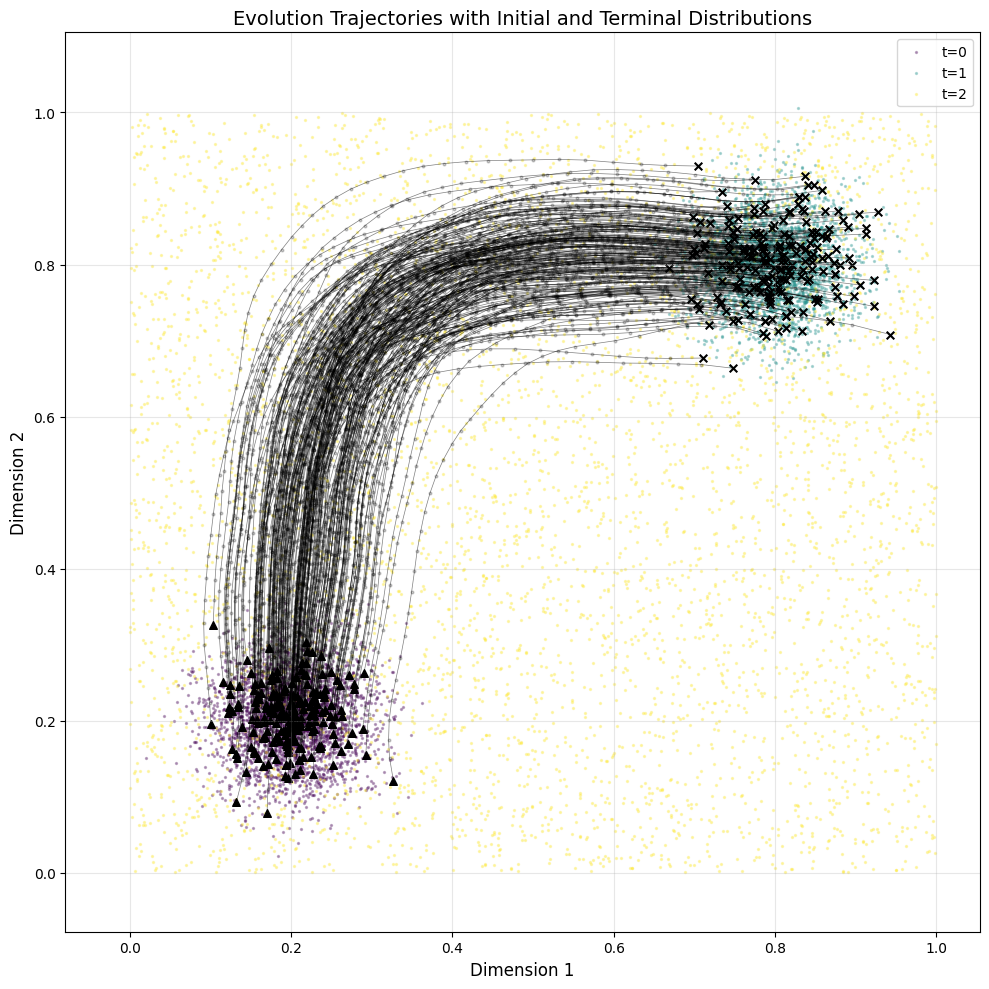

In [100]:
def gaussian_kernel(window_size=5, std=1.0, device=torch.device("cuda:0")):
    center = window_size // 2
    x = torch.arange(window_size, device=device) - center
    kernel = torch.exp(-0.5 * (x / std)**2)
    kernel = kernel / kernel.sum()
    return kernel.view(1, 1, -1)  # shape (1, 1, window_size)
import torch.nn.functional as F

def smooth_trajectory(trajectory, window_size=5):
    """
    Smooth the trajectory (keep the first and last frame unchanged), support efficient vectorization.
    
    Args:
        trajectory: (N_time, Sample, dim)
        window_size: odd, window size

    Returns:
        smoothed: (N_time, Sample, dim)
    """
    assert window_size % 2 == 1, "window_size must be odd."
    N_time, Sample, dim = trajectory.shape
    half_w = window_size // 2

    # 1. reshape: (Sample * dim, N_time)
    traj = trajectory.permute(1, 2, 0).reshape(Sample * dim, N_time).unsqueeze(1)  # (Batch, 1, Time)

    # 2. padding: keep boundary
    traj_padded = F.pad(traj, pad=(half_w, half_w), mode='replicate')  # (Batch, 1, Time + pad)

    # 3. Gaussian kernel
    kernel = gaussian_kernel(window_size=window_size, std=2.0, device=trajectory.device)

    # 4. Apply convolution
    smoothed = F.conv1d(traj_padded, kernel, groups=1)  # (Batch, 1, Time)

    # 5. Reshape back
    smoothed = smoothed.squeeze(1).reshape(Sample, dim, N_time).permute(2, 0, 1).contiguous()  # (N_time, Sample, dim)

    # 6. Force boundary unchanged
    smoothed[0] = trajectory[0]
    smoothed[-1] = trajectory[-1]

    return smoothed

smoothed_trajectory = smooth_trajectory(mapped_mainfold_trajectory, window_size=5)

plot_trajectory_and_distribution(secondary_data, smoothed_trajectory.cpu().numpy(), n_trajectories=200)

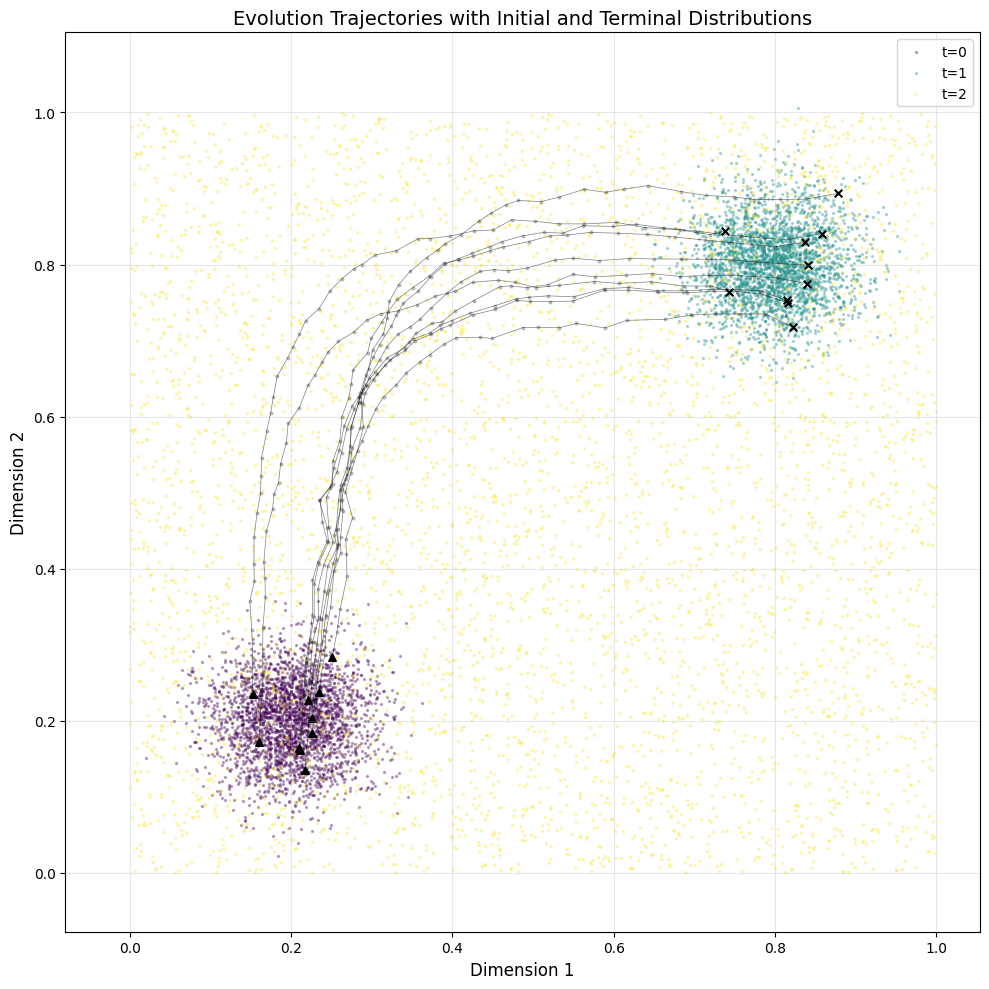

In [101]:
plot_trajectory_and_distribution(secondary_data, mapped_mainfold_trajectory.cpu().numpy(), n_trajectories=10)

In [102]:
from src.plot import visualize_evolution
reverse_trajectory = torch.flip(smoothed_trajectory, dims=[0])
visualization = visualize_evolution(
    reverse_trajectory, 
    terminal_samples=secondary_data[-1],
    save_path='evolution_animation_2nd_reconstruction.gif', 
    fps=10, 
    dpi=100  
)
display(visualization)